In [1]:
using Random 
using Plots 
using Catalyst
using DifferentialEquations
using Combinatorics
using Colors
using ColorSchemes
# using ColorTypes
using LinearAlgebra
# using Latexify

In [2]:
trimer_rn = @reaction_network trirn begin
    (ka1,kb1), L + K <--> LK
    kcat1, LK --> Lp + K 
    (ka2,kb2), Lp + A <--> LpA 
    (ka3,kb3), LpA + K <--> LpAK  
    (ka1*y,kb1), LpAK + L <--> LpAKL
    kcat1, LpAKL --> Lp + LpAK  
    (ka7,kb7), Lp + P <--> LpP 
    kcat7, LpP --> L + P
    (ka4,kb4), LpA + P <--> LpAP 
    (ka7*y,kb7), Lp + LpAP <--> LpAPLp
    kcat7, LpAPLp --> L + LpAP 
    (ka8,kb8), LpA + T <--> X

    (ka1m, kb1m), X + B <--> XB 
    (ka1m, kb1m), X + C <--> XC 
    (ka1m, kb1m), X + D <--> XD 
    (ka4m, kb4m), XB + C <--> XBC
    (ka4m*y, kb4m), XB + XC <--> XXBC
    (ka4m, kb4m), XC + B <--> XBC
    (ka5m, kb5m), XB + D <--> XBD
    (ka5m*y, kb5m), XB + XD <--> XXBD
    (ka5m, kb5m), XD + B <--> XBD
    (ka6m, kb6m), XC + D <--> XCD
    (ka6m*y, kb6m), XC + XD <--> XXCD
    (ka6m, kb6m), XD + C <--> XCD 
    (ka7m, kb7m), XBC + D <--> XBCD 
    (ka7m, kb7m), XXBC + D <--> XXBCD
    (ka7m*y, kb7m), XXBC + XD <--> XXXBCD
    (ka8m, kb8m), XBD + C <--> XBCD 
    (ka8m, kb8m), XXBD + C <--> XXBCD 
    (ka8m*y, kb8m), XXBD + XC <--> XXXBCD
    (ka9m, kb9m), XCD + B <--> XBCD 
    (ka9m, kb9m), XXCD + B <--> XXBCD 
    (ka9m*y, kb9m), XXCD + XB <--> XXXBCD 
    (ka1m*y, kb1m), XBC + X <--> XXBC 
    (ka1m*y, kb1m), XBD + X <--> XXBD 
    (ka1m*y, kb1m), XCD + X <--> XXCD 
    (ka1m*y, kb1m), XBCD + X <--> XXBCD 
    (ka1m*y, kb1m), XXBCD + X <--> XXXBCD 
end ka1 kb1 kcat1 ka2 kb2 ka3 kb3 ka4 kb4 ka7 kb7 kcat7 ka8 kb8 ka1m kb1m ka4m kb4m ka5m kb5m ka6m kb6m ka7m kb7m ka8m kb8m ka9m kb9m y 

Model trirn
States (29):
  L(t)
  K(t)
  LK(t)
  Lp(t)
  A(t)
  LpA(t)
⋮
Parameters (29):
  ka1
  kb1
  kcat1
  ka2
  kb2
  ka3
⋮

In [130]:
#parameter list
p = [14.766654049574964, 247.74197239200362, 500.0, 31.051821195245743, 158.0304365645891, 52.425931974326005, 500.0, 29.68965224106596, 
3.1517004441718446, 90.20783657199675, 364.05856621148223, 96.68089672060627, 100.0, 178.4206713875396, 63.913390412700274, 16.670218374002296, 
31.00096833128655, 187.53746678023433, 24.208313355774997, 299.70860654065797, 62.268232479997536, 500.0, 13.217117644835021, 69.69105864551203, 
79.85635210382746, 247.8070093520743, 6.034069612733998, 28.445138804106804, 0.7817627051993913/0.001]

#initial condition list
u0 = [0. , 0.2, 0. , 3. , 0.9, 0. , 0. , 0. , 0.3, 0. , 0. , 0. , 0.3,
1. , 0.5, 0., 0.5, 0.0 , 0.5 , 0. , 0. , 0. , 0. , 0. , 0. , 0. ,
0. , 0. , 0. ]

29-element Vector{Float64}:
 0.0
 0.2
 0.0
 3.0
 0.9
 0.0
 0.0
 0.0
 0.3
 0.0
 0.0
 0.0
 0.3
 ⋮
 0.0
 0.5
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0

In [131]:
pmap = [x => y for (x,y) in zip(parameters(trimer_rn),p)]
pmap = symmap_to_varmap(trimer_rn, pmap)

29-element Vector{Pair{Sym{Real, Base.ImmutableDict{DataType, Any}}, Float64}}:
   ka1 => 14.766654049574964
   kb1 => 247.74197239200362
 kcat1 => 500.0
   ka2 => 31.051821195245743
   kb2 => 158.0304365645891
   ka3 => 52.425931974326005
   kb3 => 500.0
   ka4 => 29.68965224106596
   kb4 => 3.1517004441718446
   ka7 => 90.20783657199675
   kb7 => 364.05856621148223
 kcat7 => 96.68089672060627
   ka8 => 100.0
       ⋮
  kb4m => 187.53746678023433
  ka5m => 24.208313355774997
  kb5m => 299.70860654065797
  ka6m => 62.268232479997536
  kb6m => 500.0
  ka7m => 13.217117644835021
  kb7m => 69.69105864551203
  ka8m => 79.85635210382746
  kb8m => 247.8070093520743
  ka9m => 6.034069612733998
  kb9m => 28.445138804106804
     y => 781.7627051993912

In [132]:
umap = [x => y for (x,y) in zip(states(trimer_rn),u0)]
umap = symmap_to_varmap(trimer_rn, umap)

29-element Vector{Pair{Term{Real, Base.ImmutableDict{DataType, Any}}, Float64}}:
      L(t) => 0.0
      K(t) => 0.2
     LK(t) => 0.0
     Lp(t) => 3.0
      A(t) => 0.9
    LpA(t) => 0.0
   LpAK(t) => 0.0
  LpAKL(t) => 0.0
      P(t) => 0.3
    LpP(t) => 0.0
   LpAP(t) => 0.0
 LpAPLp(t) => 0.0
      T(t) => 0.3
           ⋮
     XC(t) => 0.0
      D(t) => 0.5
     XD(t) => 0.0
    XBC(t) => 0.0
   XXBC(t) => 0.0
    XBD(t) => 0.0
   XXBD(t) => 0.0
    XCD(t) => 0.0
   XXCD(t) => 0.0
   XBCD(t) => 0.0
  XXBCD(t) => 0.0
 XXXBCD(t) => 0.0

In [133]:
tspan = (0.,20.)

# odesys = convert(ODESystem, trimer_rn; combinatoric_ratelaws=true)
oprob = ODEProblem(trimer_rn, umap, tspan, pmap)
osol = solve(oprob, Tsit5())

retcode: Success
Interpolation: specialized 4th order "free" interpolation
t: 244962-element Vector{Float64}:
  0.0
  1.0687961716468007e-5
  2.3353780197160076e-5
  4.330644560832675e-5
  6.822565288233978e-5
  9.221021160165357e-5
  0.00011237347709112988
  0.00012941827194870234
  0.0001449183729469136
  0.0001601468527107682
  0.00017579524513385193
  0.00019207463422179984
  0.0002088765795253306
  ⋮
 19.99906674807222
 19.999157159742282
 19.99924757447457
 19.999337992281166
 19.9994284131502
 19.99951883708177
 19.99960926408796
 19.999699694174872
 19.99979012733661
 19.999880563579275
 19.999971002896977
 20.0
u: 244962-element Vector{Vector{Float64}}:
 [0.0, 0.2, 0.0, 3.0, 0.9, 0.0, 0.0, 0.0, 0.3, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
 [4.470798300275378e-7, 0.19999984345995897, 4.697849219828047e-12, 2.998242399026792, 0.8991069933396896, 0.002796427962355861, 1.5653534146856334e-7, 1.7263010095759877e-15, 0.29913577897958693, 0.0008640880674735511  …  0

In [58]:
# Create a custom color gradient
function plotfig1!(plt, osol;tend=length(osol))

    tend = Int(round(tend))

    # First Plot
    plot!(plt,osol.t[1:tend], osol[1,1:tend], color = :blue, label = "PIP", ylims = (0, 3.5))
    plot!(plt, osol.t[1:tend], osol[4,1:tend], color = :orange, label = "PIP2")
    plot!(plt, osol.t[1:tend], osol[5,1:tend], color = :red, label = "AP2")
    plot!(plt, osol.t[1:tend], osol[end,1:tend], color = :magenta, label = "XXXBCD")
end

plotfig1! (generic function with 1 method)

In [75]:
# Create a custom color gradient
function plotfig2!(plt, osol;tend=length(osol))
    color_gradient = palette([:purple, :magenta], 10)

    tend = Int(round(tend))

    # Second Plot
    plot!(plt,osol.t[1:tend], osol[14,1:tend], color = color_gradient[1], line = :dot, label = "X", ylims = (0,0.2))
    plot!(plt, osol.t[1:tend], osol[16,1:tend], color = color_gradient[2], line = :dot, label = "XA")
    plot!(plt, osol.t[1:tend], osol[end-8,1:tend], color = color_gradient[3], line = :dot, label = "XAB")
    plot!(plt, osol.t[1:tend], osol[end-7,1:tend], color = color_gradient[4], line = :dot, label = "XXAB")
    plot!(plt, osol.t[1:tend], osol[end-2,1:tend], color = color_gradient[5], line = :dot, label = "XABC")
    plot!(plt, osol.t[1:tend], osol[end-1,1:tend], color = color_gradient[6], line = :dot, label = "XXABC")
    plot!(plt, osol.t[1:tend], osol[end,1:tend], color = color_gradient[end], label = "XXXBCD")
end

plotfig2! (generic function with 1 method)

[ Info: Saved animation to /Users/jonathanfischer/Desktop/Julia/Self-assembly/gif1.gif


Plots.AnimatedGif("/Users/jonathanfischer/Desktop/Julia/Self-assembly/gif1.gif")
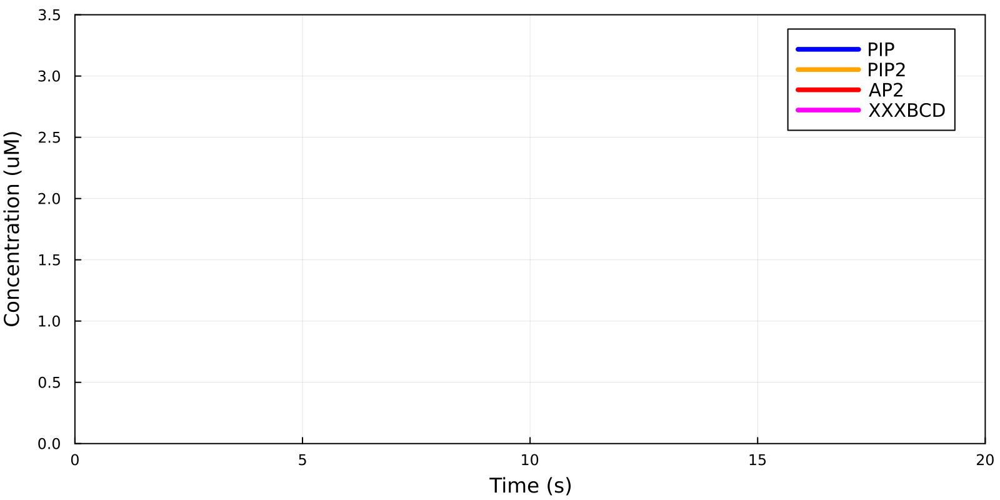

In [77]:
using Plots.PlotMeasures
tframe = range(1,stop=length(osol.t),length=100)
default(linewidth = 3.0)

# plt = plot()
gif1 = @animate for i in tframe
    # idx = Int(round(i))
    plt1 = plot(dpi = 200,size = (800, 400), legend = :topright, xlims = (0,20), bottom_margin = 10px, left_margin = 10px, framestyle=:box, legendfontsize=10)
    # ylims!(plt[1], (0, 3.5))
    xlabel!("Time (s)")
    ylabel!("Concentration (uM)")
    # title!("Trimerization Reaction")
    plotfig1!(plt1,osol;tend=i)
end 
gif(gif1, "gif1.gif")

[ Info: Saved animation to /Users/jonathanfischer/Desktop/Julia/Self-assembly/gif2.gif


Plots.AnimatedGif("/Users/jonathanfischer/Desktop/Julia/Self-assembly/gif2.gif")
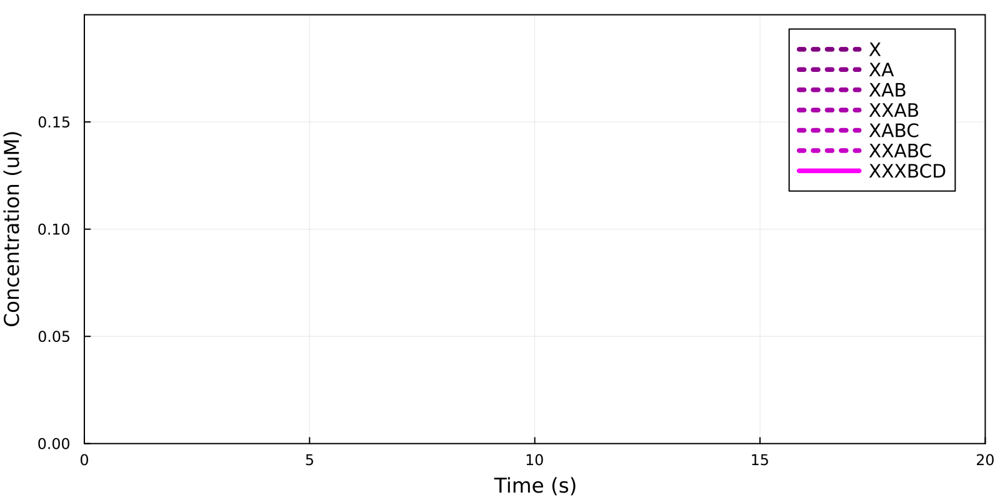

In [78]:
gif2 = @animate for i in tframe
    plt2 = plot(dpi = 200,size = (800, 400), legend = :topright, xlims = (0,20),bottom_margin = 10px, left_margin = 10px, framestyle=:box,legendfontsize=10)
    xlabel!("Time (s)")
    ylabel!("Concentration (uM)")
    # title!("Trimerization Reaction")
    plotfig2!(plt2,osol;tend=i)
end 
gif(gif2, "gif2.gif")

In [107]:
function find_idx(pmap, p)
    for (i, (k,v)) in enumerate(pmap)
        if string(k) == p
            return i
        end
    end
end

find_idx (generic function with 1 method)

In [108]:
find_idx(pmap, "ka1")

1

In [151]:
p1 = plot(osol[2,:],osol[end,:], label = "V/A")

pcopy = copy(p)
idx = find_idx(pmap, "y")


color_gradient = cgrad(:plasma, 5, categorical = true)

for (i,c) in enumerate(color_gradient)
    pcopy[idx] = pcopy[idx]*1.1
    println(pcopy[idx])
    newpmap = [x => y for (x,y) in zip(parameters(trimer_rn),pcopy)]
    newpmap = symmap_to_varmap(trimer_rn, newpmap)
    newprob = ODEProblem(trimer_rn, umap, tspan, newpmap)
    newsol = solve(newprob, Tsit5())
    plot!(p1,newsol[2,:],newsol[end,:],c = c, label = "V/A * $(1.1+0.1*i)")
end

scatter!((osol[2,1],osol[end,1]), label = "Start")
scatter!((osol[2,end],osol[end,end]), label = "End")
xlabel!("PIP5K Kinase (uM)")
ylabel!("XXXBCD Trimer (uM)")
display(p1)

859.9389757193304
945.9328732912635
1040.5261606203899
1144.578776682429
1259.036654350672


In [139]:
find_idx(umap, "L(t)")

1

In [150]:
idx1, idx2, idx3 = find_idx(umap, "XXXBCD(t)"), find_idx(umap, "Lp(t)"),  find_idx(umap,"LpAK(t)")
plot(osol[idx1,:],osol[idx2,:],osol[idx3,:])

In [137]:
umap

29-element Vector{Pair{Term{Real, Base.ImmutableDict{DataType, Any}}, Float64}}:
      L(t) => 0.0
      K(t) => 0.2
     LK(t) => 0.0
     Lp(t) => 3.0
      A(t) => 0.9
    LpA(t) => 0.0
   LpAK(t) => 0.0
  LpAKL(t) => 0.0
      P(t) => 0.3
    LpP(t) => 0.0
   LpAP(t) => 0.0
 LpAPLp(t) => 0.0
      T(t) => 0.3
           ⋮
     XC(t) => 0.0
      D(t) => 0.5
     XD(t) => 0.0
    XBC(t) => 0.0
   XXBC(t) => 0.0
    XBD(t) => 0.0
   XXBD(t) => 0.0
    XCD(t) => 0.0
   XXCD(t) => 0.0
   XBCD(t) => 0.0
  XXBCD(t) => 0.0
 XXXBCD(t) => 0.0